In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [3]:
import numpy as np
from tqdm import tqdm
from pathlib import Path
import openslide
import pandas as pd

In [4]:
from fastai.callbacks.csv_logger import CSVLogger

In [5]:
from object_detection_fastai.helper.object_detection_helper import *
from object_detection_fastai.helper.wsi_loader import *
from object_detection_fastai.loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from object_detection_fastai.models.RetinaNet import RetinaNet
from object_detection_fastai.callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric, PascalVOCMetricByDistance

In [6]:
slides_train = list(set(['BAL Promyk Spray 4.svs',
                         'BAL AIA Blickfang Luft.svs']))

slides_val = list(set(['BAL 1 Spray 2.svs', 
                         'BAL Booker Spray 3.svs',
                         'BAL Bubi Spray 1.svs', 
                         'BAL cent blue Luft 2.svs']))

labels = ['Makrophagen']

In [7]:
experiment_name = "Asthma-L0"

In [8]:
annotations_path = Path("../Statistics/Asthma_Annotations.pkl")
annotations = pd.read_pickle(annotations_path)

annotations = annotations[annotations["class"].isin(labels)]
annotations_train = annotations[annotations["image_name"].isin(slides_train)]
annotations_val = annotations[annotations["image_name"].isin(slides_val)]
annotations_train.head()

,id,image_id,image_name,image_set,class,vector,unique_identifier,user_id,deleted,last_editor
21105,140917,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14371, 'x2': 14435, 'y1': 14738, 'y2': ...",2c2f610e-f4f7-4e05-8236-ffa28418550d,10,False,None
21106,140918,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14066, 'x2': 14152, 'y1': 14692, 'y2': ...",bcf159fc-2a41-4a69-a4cd-9b48da8fc663,10,False,None
21107,140919,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14377, 'x2': 14451, 'y1': 14646, 'y2': ...",f5e247d5-9c38-4e22-9329-56805024cf83,10,False,None
21108,140920,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14304, 'x2': 14384, 'y1': 14600, 'y2': ...",f68910d0-eb8f-4715-ad8d-accd060efff1,10,False,None
21109,140921,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14318, 'x2': 14402, 'y1': 14544, 'y2': ...",013f3fc1-b603-41ce-8357-e446db2c9a14,10,False,None


In [18]:
annotations["width"] = [vector["x2"] - vector["x1"] for vector in annotations["vector"]]
annotations["height"] = [vector["y2"] - vector["y1"] for vector in annotations["vector"]]
annotations["scale"] = annotations["width"] / annotations["height"]

<AxesSubplot:xlabel='width', ylabel='height'>

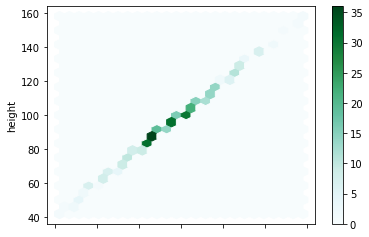

In [23]:
annotations.plot.hexbin(x='width', y='height', gridsize=25) #C='scale', 

In [17]:
print(annotations_train.shape)

(20682, 10)


In [9]:
slides_path = Path("../Slides")
files = {slide.name: slide for slide in slides_path.rglob("*.svs") if slide.name in slides_train + slides_val}
files

{'BAL 1 Spray 2.svs': WindowsPath('../Slides/BAL 1 Spray 2.svs'),
 'BAL AIA Blickfang Luft.svs': WindowsPath('../Slides/BAL AIA Blickfang Luft.svs'),
 'BAL Booker Spray 3.svs': WindowsPath('../Slides/BAL Booker Spray 3.svs'),
 'BAL Bubi Spray 1.svs': WindowsPath('../Slides/BAL Bubi Spray 1.svs'),
 'BAL cent blue Luft 2.svs': WindowsPath('../Slides/BAL cent blue Luft 2.svs'),
 'BAL Promyk Spray 4.svs': WindowsPath('../Slides/BAL Promyk Spray 4.svs')}

In [10]:
size = 1024 
level = 0
bs = 16
train_images = 500
val_images = 500

In [11]:
train_files = []
val_files = []

In [12]:
for image_name in annotations_train["image_name"].unique():
    
    annotations = annotations_train[annotations_train["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)

    train_files.append(SlideContainer(slide_path, y=[bboxes, labels],  level=level, width=size, height=size))
    
for image_name in annotations_val["image_name"].unique():
    
    annotations = annotations_val[annotations_val["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)

    val_files.append(SlideContainer(slide_path, y=[bboxes, labels],  level=level, width=size, height=size))

train_files = list(np.random.choice(train_files, train_images))
valid_files = list(np.random.choice(val_files, val_images))

In [13]:
tfms = get_transforms(do_flip=True,
                      flip_vert=True,
                      #max_rotate=90,
                      #max_lighting=0.0,
                      #max_zoom=1.,
                      #max_warp=0.0,
                      #p_affine=0.5,
                      #p_lighting=0.0,
                      #xtra_tfms=xtra_tfms,
                     )

In [14]:
def get_y_func(x):
    return x.y

In [15]:
train =  ObjectItemListSlide(train_files, path=slides_path)
valid = ObjectItemListSlide(valid_files, path=slides_path)
item_list = ItemLists(slides_path, train, valid)
lls = item_list.label_from_func(get_y_func, label_cls=SlideObjectCategoryList) #
lls = lls.transform(tfms, tfm_y=True, size=size)
data = lls.databunch(bs=bs, collate_fn=bb_pad_collate, num_workers=0).normalize()

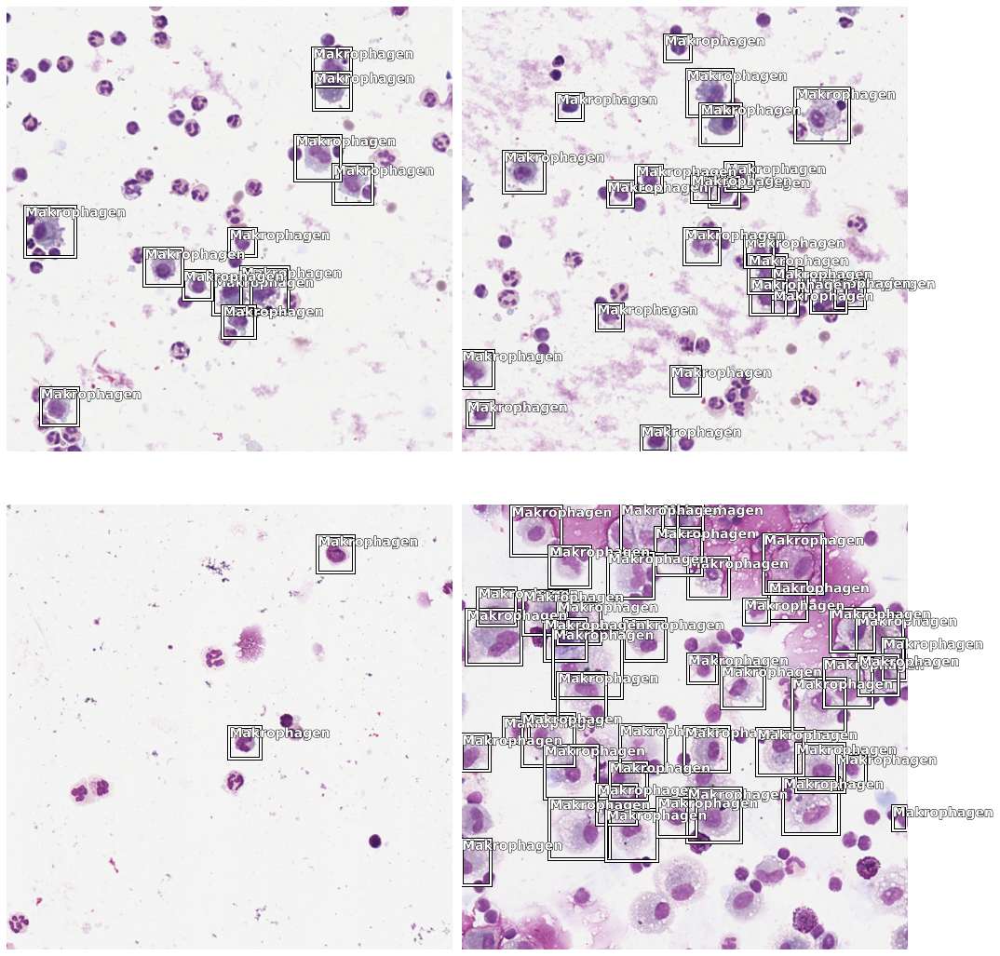

In [16]:
data.show_batch(rows=2, ds_type=DatasetType.Valid, figsize=(15,15))

In [41]:
scales = [0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1.1]
anchors = create_anchors(sizes=[(32,32)], ratios=[1], scales=scales)

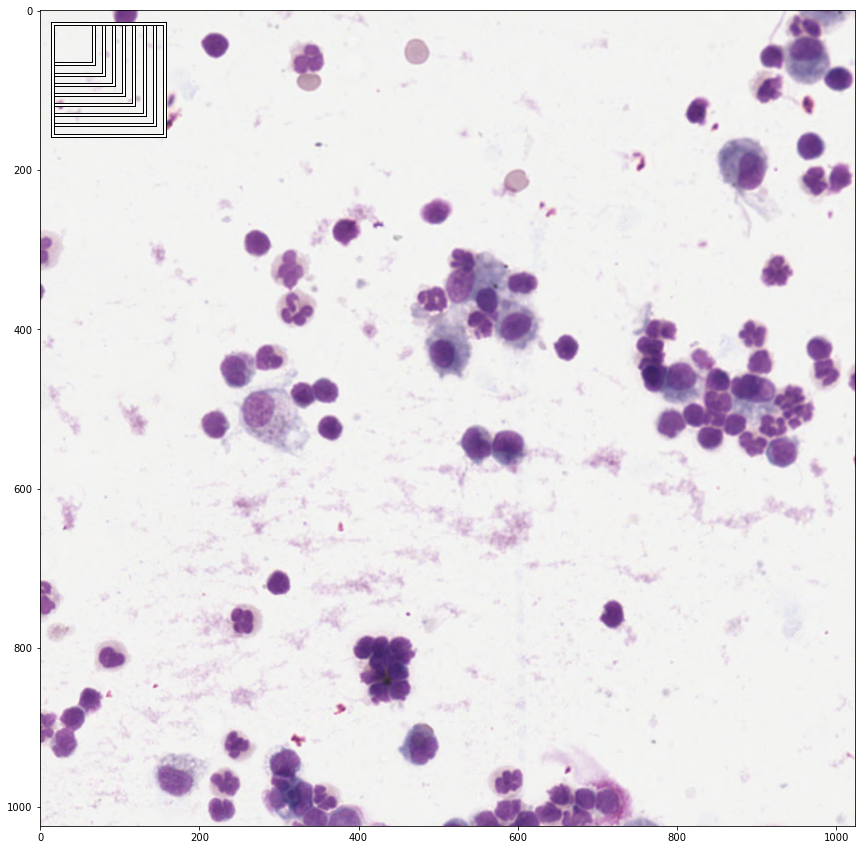

In [42]:
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:len(scales)]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

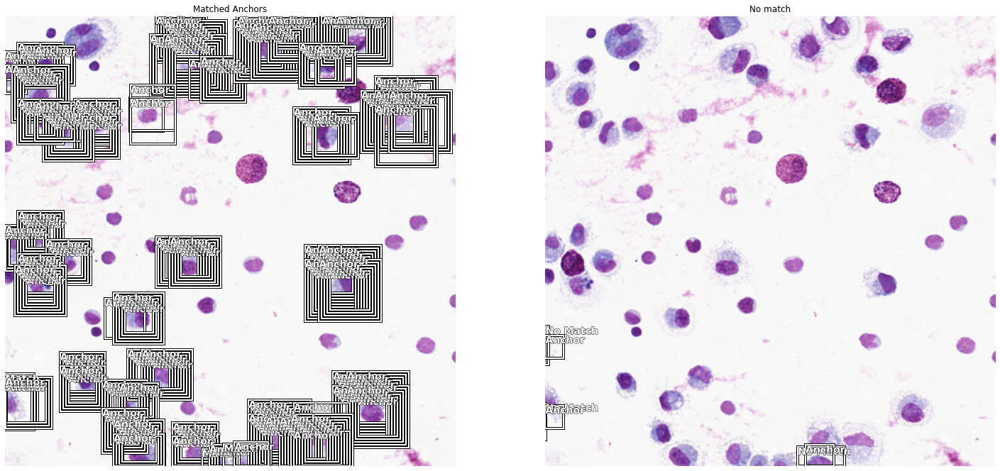

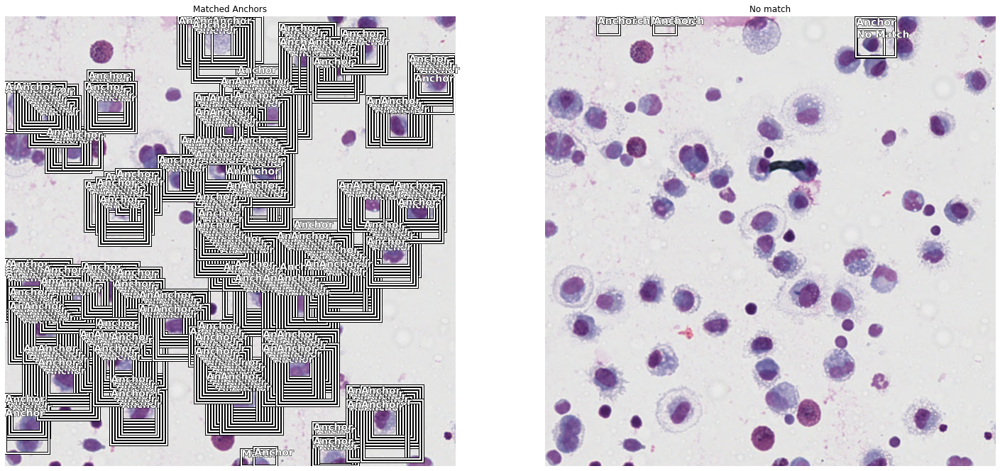

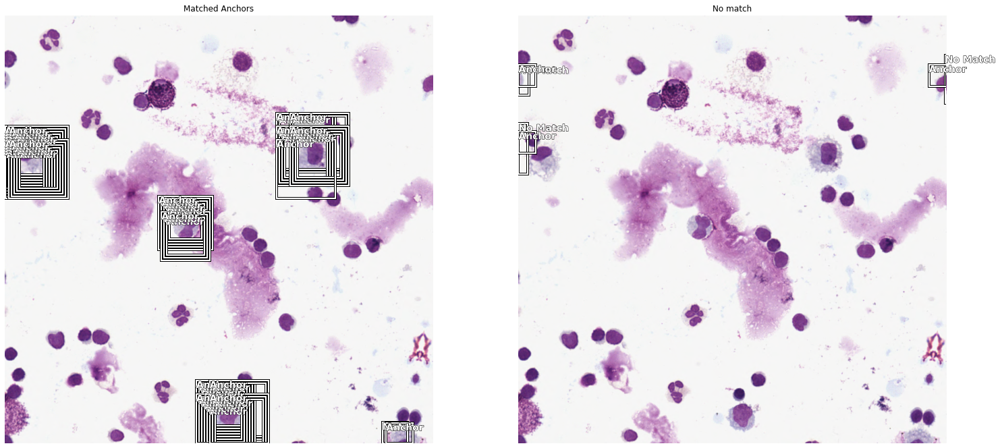

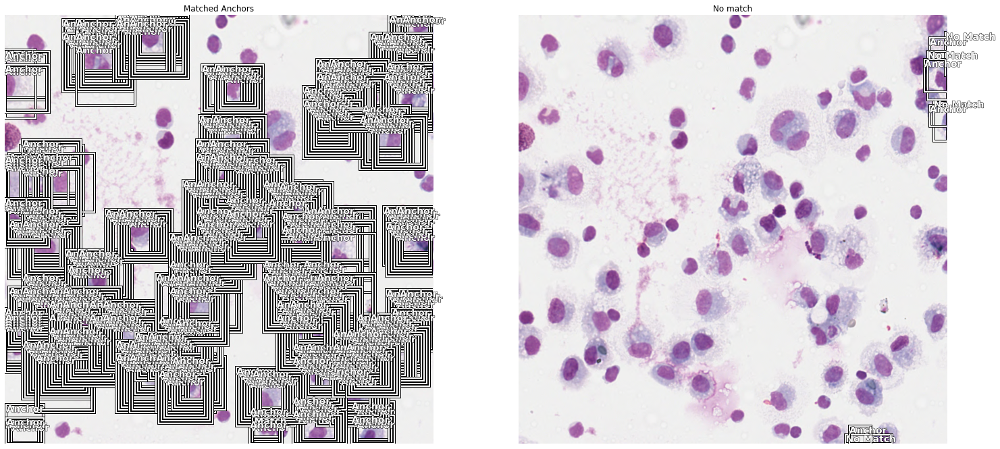

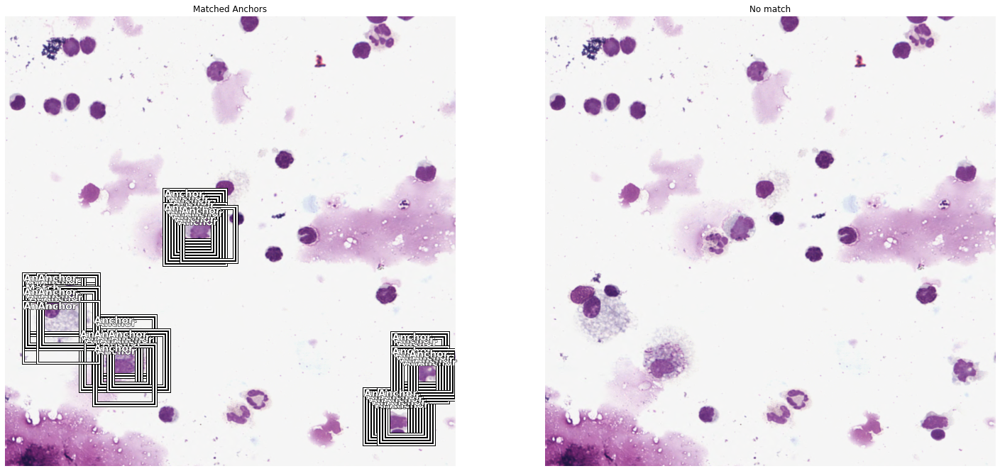

...

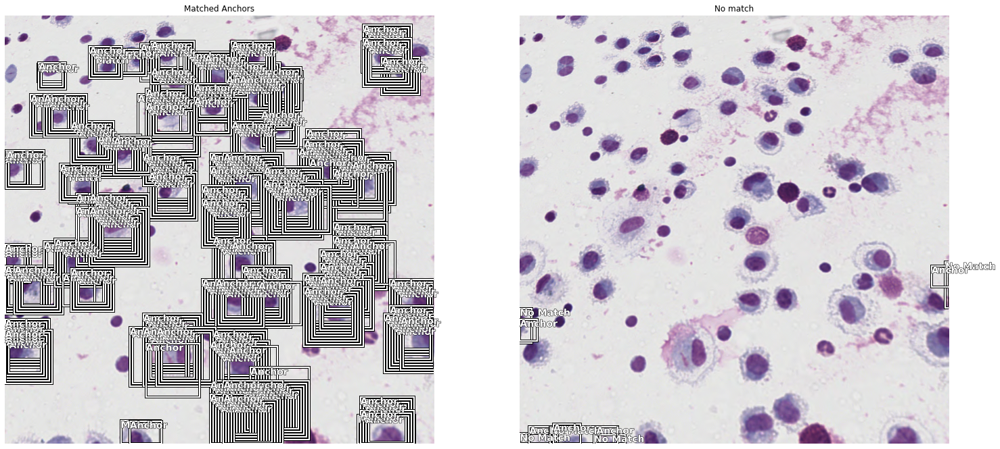

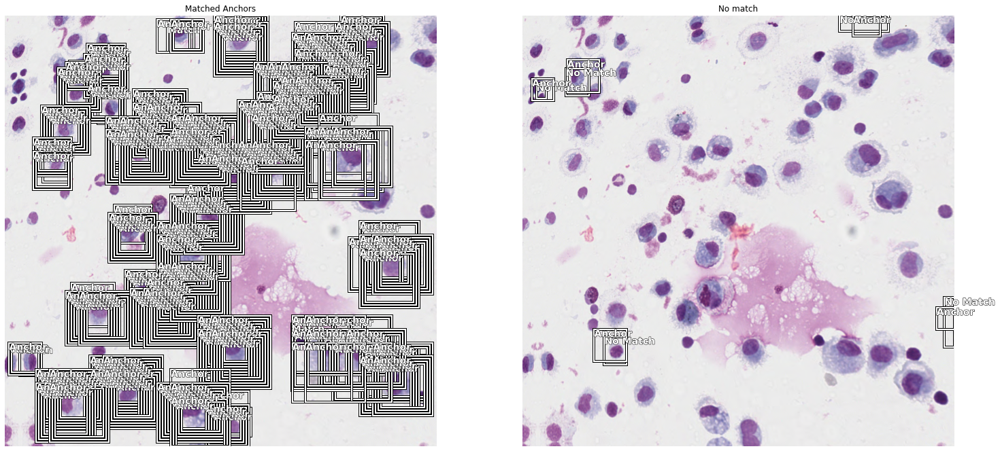

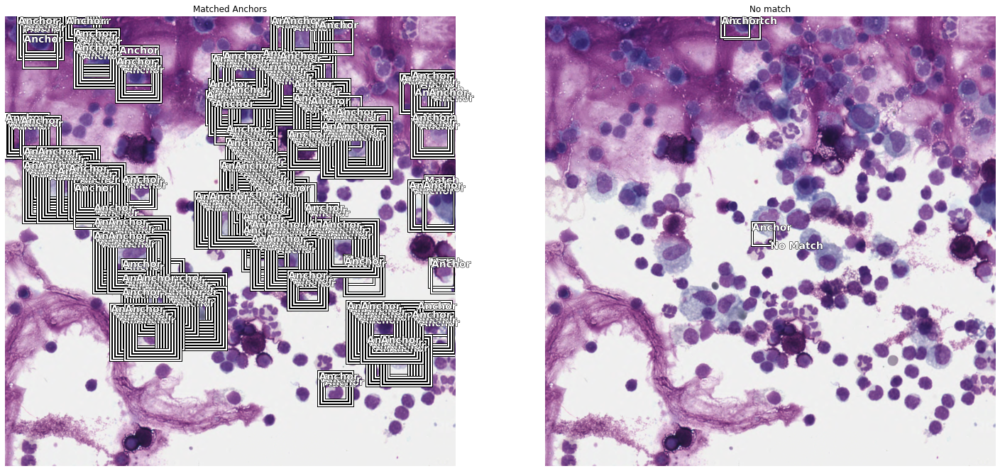

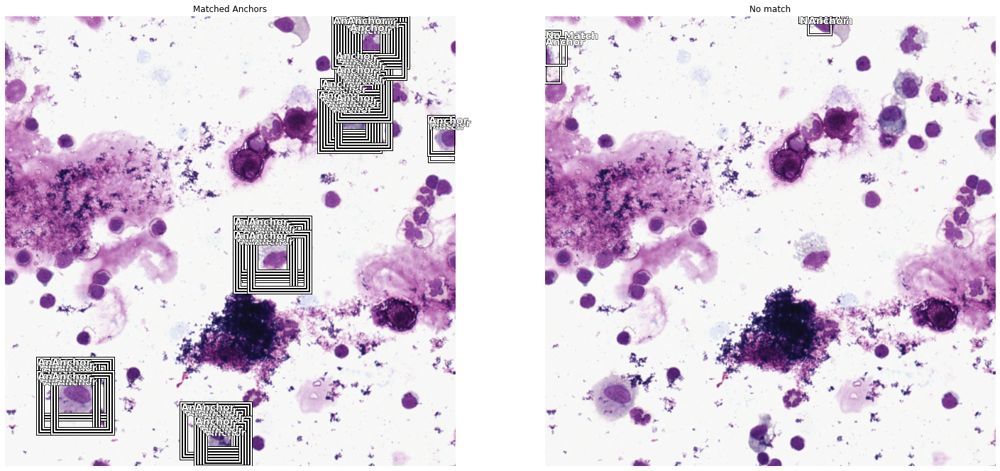

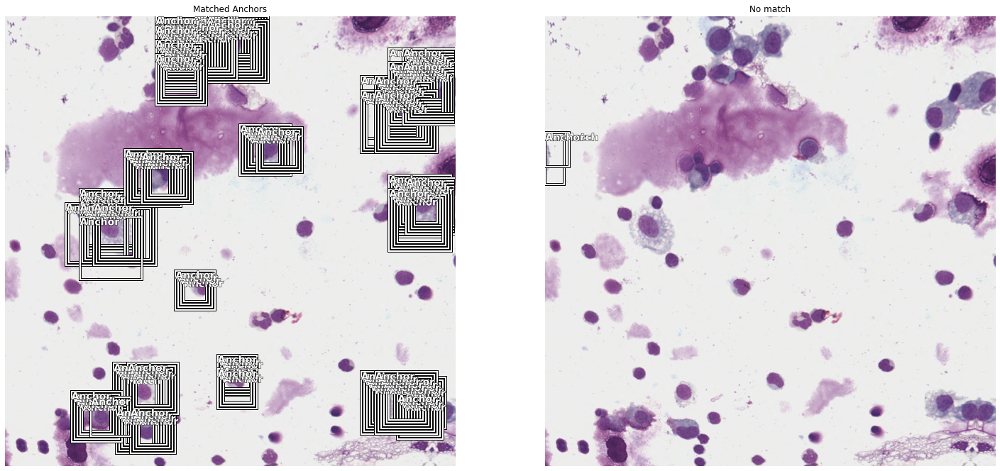

In [43]:
all_boxes, all_labels = show_anchors_on_images(data, anchors, figsize=(25,25))

In [45]:
n_classes = data.train_ds.c

crit = RetinaNetFocalLoss(anchors)

encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=len(scales), sizes=[32], chs=128, final_bias=-4., n_conv=2)

In [46]:
voc = PascalVOCMetricByDistance(anchors, size, [str(i) for i in data.train_ds.y.classes[1:]], radius=40)
learn = Learner(data, model, loss_func=crit, callback_fns=[BBMetrics], #BBMetrics, ShowGraph
                metrics=[voc])

In [47]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

In [48]:
learn.fit_one_cycle(3, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Makrophagen,time
0,1.177560,0.816297,0.509699,0.239907,0.576391,0.509699,06:44
1,0.652645,0.463324,0.644121,0.144799,0.318525,0.644121,06:45
2,0.452489,0.409459,0.631954,0.143426,0.266033,0.631954,06:27


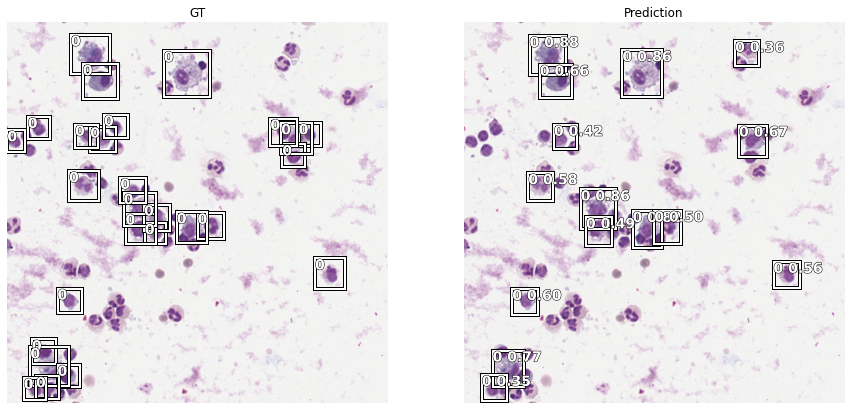

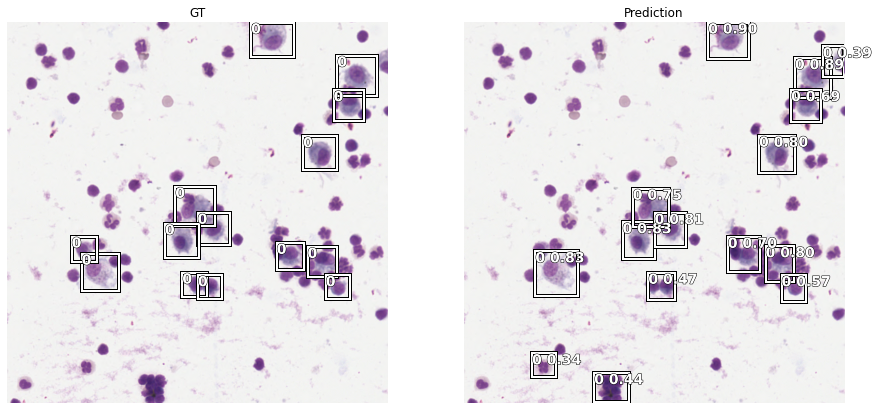

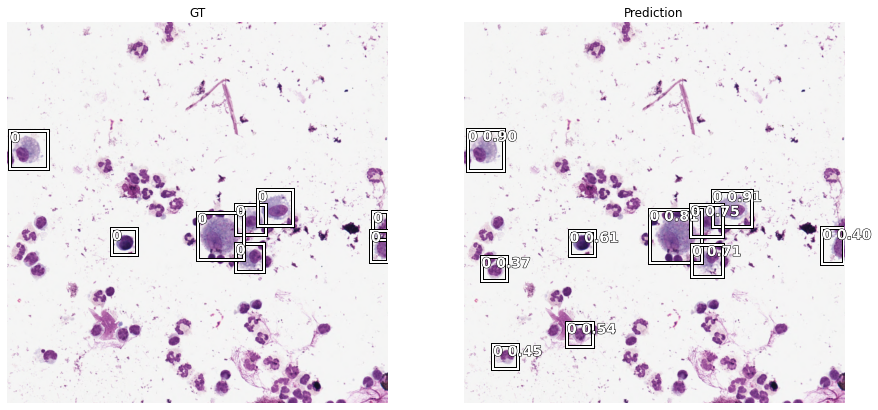

In [50]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.2, image_count=3)

In [51]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Makrophagen,time
0,0.253774,0.440667,0.624307,0.159054,0.281612,0.624307,07:07
1,0.266400,0.563362,0.557427,0.184266,0.379096,0.557427,08:08
2,0.320660,0.825525,0.702371,0.157829,0.667696,0.702371,46:12
3,0.290175,0.451807,0.638032,0.145373,0.306434,0.638032,06:12
4,0.263251,0.353587,0.718889,0.110798,0.242789,0.718889,06:08
5,0.236150,0.462929,0.696796,0.143980,0.318949,0.696796,05:45
6,0.215845,0.336876,0.682755,0.105562,0.231314,0.682755,05:35
7,0.194217,0.326740,0.668388,0.091695,0.235045,0.668388,05:37
8,0.181205,0.308413,0.694474,0.089176,0.219237,0.694474,05:38
9,0.171495,0.318263,0.689904,0.100604,0.217659,0.689904,05:45


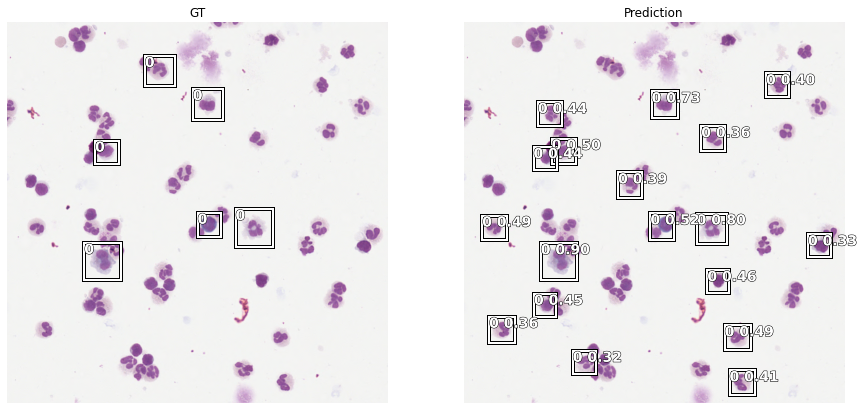

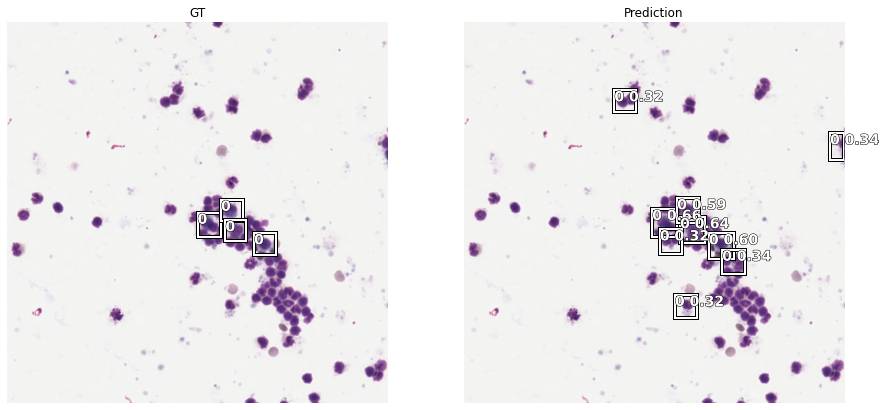

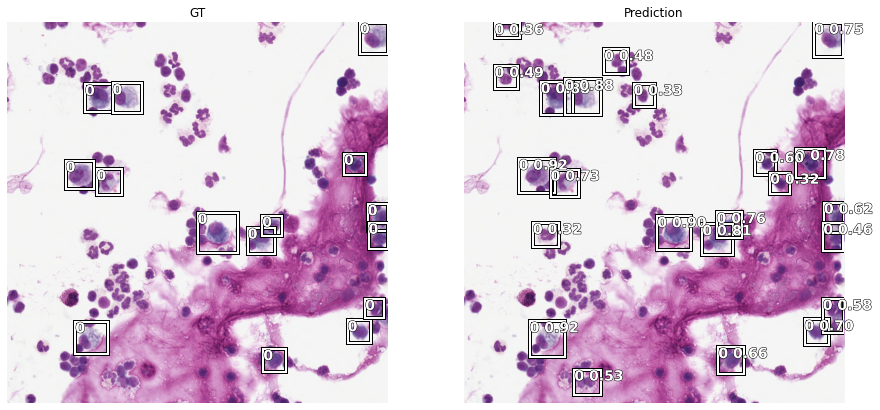

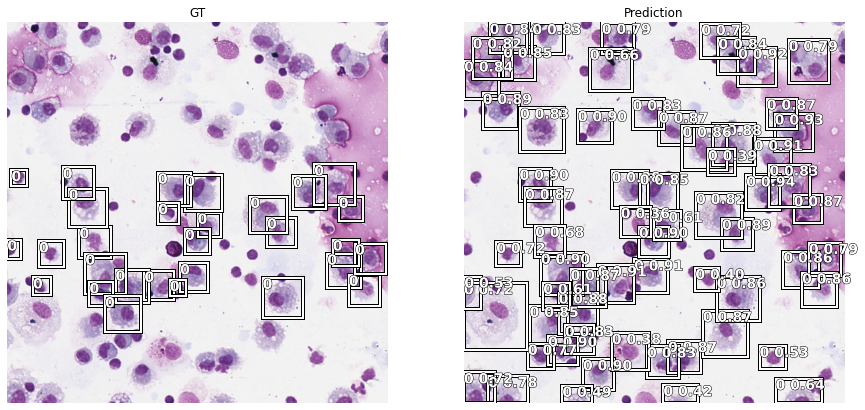

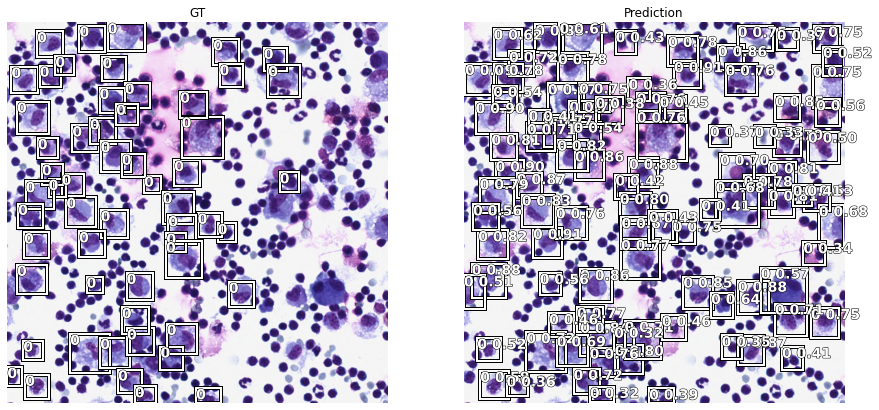

In [52]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.2)